In [1]:
# -*- coding: utf-8 -*-

"""

Side-Channel Analysis 101
2. differential power analysis on DES hardware implementation

DPA contest v1

lasf modified 2022.04.26

----------------------------------------------------
Sunghyun Jin
sunghyunjin@korea.ac.kr
https://sunghyunjin.com

Cryptographic Algorithm Lab.

School of Cyber Security,
Korea University,
Republic of Korea

Center for Information Security Technologies (CIST),
Institute of Cyber Security & Privacy (ICSP),
Korea University,
Republic of Korea
----------------------------------------------------
"""
print('')

In [2]:
import struct
import os

import h5py
import numpy as np
import scipy.io as spio
import tqdm

import matplotlib.pyplot as plt
%matplotlib inline

from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.resources import INLINE
from bokeh.models import Span
from bokeh.palettes import Spectral11

output_notebook(INLINE)

Loading BokehJS ...

In [3]:
def check_file_exists(file_path, verbose = True):
    if os.path.exists(file_path) == False:
        if verbose:
            print("Error: provided file path '%s' does not exist!" % file_path)
        return False
    if verbose:
        print("EXIST :", file_path)
    return True

## 1. Data Loading

In [4]:
fpath = '../dataset'
fname = fpath + '/secmatv1_2006_04_0809.h5'

if check_file_exists(fname):
    h5f = h5py.File(fname, 'r')
    
    print(list(h5f.keys()))
    
    print('traces     :', h5f['traces'].shape)
    print('plaintext  :', h5f['plaintext'].shape)
    print('ciphertext :', h5f['ciphertext'].shape)
    print('key        :', h5f['key'].shape)
    
    tr = h5f['traces'][:]
    pt = h5f['plaintext'][:]
    pt = pt.astype(np.uint8)
    ct = h5f['ciphertext'][:]
    ct = ct.astype(np.uint8)
    key = h5f['key'][0]
    key = key.astype(np.uint8)
    
    h5f.close()

EXIST : ../dataset/secmatv1_2006_04_0809.h5
['ciphertext', 'key', 'plaintext', 'traces']
traces     : (3085, 20003)
plaintext  : (3085, 8)
ciphertext : (3085, 8)
key        : (1, 8)


In [5]:
print('key :', ['%02X' % i for i in key])

key : ['6A', '65', '78', '6A', '65', '78', '6A', '65']


## 2. Visual Inspection (SPA, Simple Power Analysis)

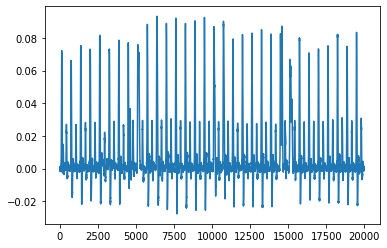

In [6]:
plt.plot(tr[0])
plt.show()

In [7]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'A total power consumption trace'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'power'

xrange = list(range(tr.shape[1]))
deltaplot.line(xrange, tr[0,:])
show(deltaplot)

In [8]:
num = 20

deltaplot = figure(plot_width=800)

deltaplot.title.text = '%d power consumption traces' % num
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'power'

xrange = list(range(tr.shape[1]))
for i, t in enumerate(tr[:num]):
    deltaplot.line(xrange, t, color = Spectral11[i % len(Spectral11)])
show(deltaplot)

In [9]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'mean trace'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'power'

xrange = list(range(tr.shape[1]))
deltaplot.line(xrange, np.mean(tr, axis=0))
show(deltaplot)

In [10]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'variance trace'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'power'

xrange = list(range(tr.shape[1]))
deltaplot.line(xrange, np.var(tr, axis=0))
show(deltaplot)

# DPA targeting plaintext & ciphertext

In [11]:
ith = 0

In [12]:
tmp = np.vectorize((lambda x: (x >> 7) & 0x1))(pt[:,0])
ind1 = np.where(tmp == 0)[0]
ind2 = np.where(tmp != 0)[0]
print('#MSB(0/1) -> {} : {}'.format(ind1.shape[0], ind2.shape[0]))

#MSB(0/1) -> 1500 : 1585


In [13]:
dom = np.mean(tr[ind1,:], axis = 0) - np.mean(tr[ind2], axis = 0)

In [14]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'Difference of Mean'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'difference'

xrange = list(range(dom.shape[0]))
deltaplot.line(xrange, dom)
show(deltaplot)

In [15]:
from des import DES

In [16]:
def calculate_dom_hd_lr(tr, pt, ithbit):
    des = DES()

    ptb = np.unpackbits(pt, axis = 1)

    buf_ip = np.zeros(ptb.shape, dtype = np.uint8)
    for i, j in enumerate(des.PI):
        buf_ip[:,i] = ptb[:,j-1]

    L = buf_ip[:,:32]
    R = buf_ip[:,32:]
    
    #tmp = np.vectorize((lambda x: (x >> bit) & 0x1))(pt[:,ith])
    tmp = np.vectorize((lambda x: (x >> ithbit) & 0x1))(L[:,ithbit] ^ R[:,ithbit])
    ind1 = np.where(tmp == 0)[0]
    ind2 = np.where(tmp != 0)[0]
    dom = np.mean(tr[ind1,:], axis = 0) - np.mean(tr[ind2,:], axis = 0)
    return dom

In [17]:
dom_hd_lr = np.zeros((32, tr.shape[1]), dtype = np.double)
for ind, ithbit in enumerate(tqdm.tqdm(range(32))):
    dom_hd_lr[ind, :] = calculate_dom_hd_lr(tr, pt, ithbit)

  0%|                                                    | 0/32 [00:00<?, ?it/s]/opt/homebrew/Caskroom/miniforge/base/envs/hw/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/homebrew/Caskroom/miniforge/base/envs/hw/lib/python3.9/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 24.39it/s]


In [18]:
#num = 8
num = dom_hd_lr.shape[0]

deltaplot = figure(plot_width=800)

deltaplot.title.text = '%d Difference of Mean' % num
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'diff'

xrange = list(range(dom_hd_lr.shape[1]))
for i, t in enumerate(dom_hd_lr[:num]):
    deltaplot.line(xrange, t, color = Spectral11[i % len(Spectral11)])
show(deltaplot)

# DPA targeting Hamming distance

[wikipedia - DES](https://en.wikipedia.org/wiki/Data_Encryption_Standard)

[fips 46-3](https://csrc.nist.gov/csrc/media/publications/fips/46/3/archive/1999-10-25/documents/fips46-3.pdf)

In [19]:
from des import DES

In [20]:
def ks(key):
    des = DES()
    
    keybits = np.unpackbits(key.reshape((-1, 1)), axis = 1).reshape((64,))
    
    buf = np.zeros((56,), dtype=np.uint8)
    for i, j in enumerate(des.PC_1):
        buf[i] = keybits[j-1]

    C = buf[:28]
    D = buf[28:]
    
    ls = [
        1, 1, 2, 2, 2, 2, 2, 2,
        1, 2, 2, 2, 2, 2, 2, 1
    ]
    
    rk = np.zeros((16, 8), dtype=np.uint8)
    
    for r in range(16):
        for bs in range(ls[r]):
            tmp = C[0]
            C[0:-1] = C[1:]
            C[-1] = tmp
            tmp = D[0]
            D[0:-1] = D[1:]
            D[-1] = tmp
        
        keybits = np.concatenate([C, D])
        
        buf = np.zeros((48,), dtype=np.uint8)
        for i, j in enumerate(des.PC_2):
            buf[i] = keybits[j-1]
        rktmp = np.zeros((8, 8), dtype = np.uint8)
        rktmp[:,2:] = buf.reshape((8,6))
        rk[r,:] = np.packbits(rktmp, axis = 1).reshape((-1,8))
    
    return rk

In [21]:
rk = ks(key)
for i, rki in enumerate(rk):
    print('%2d round key :' % (i+1), ''.join(['%02X ' % li for li in rki]))

 1 round key : 38 0B 3B 26 00 0D 19 37 
 2 round key : 38 0B 19 36 3A 05 26 08 
 3 round key : 39 0D 39 36 00 07 08 3F 
 4 round key : 39 2F 0D 32 3D 31 22 20 
 5 round key : 2B 2D 1D 33 20 00 2D 3B 
 6 round key : 3B 35 0D 1B 05 3B 28 14 
 7 round key : 0B 3D 0F 19 1C 10 17 30 
 8 round key : 07 35 27 1B 02 1A 20 0F 
 9 round key : 07 34 2F 19 0C 00 1F 29 
10 round key : 07 37 26 1D 26 2B 20 03 
11 round key : 07 32 37 0D 19 26 1C 30 
12 round key : 16 36 32 2D 0E 12 25 0A 
13 round key : 36 1A 36 2C 39 0D 00 12 
14 round key : 34 0A 3A 2F 11 12 19 2E 
15 round key : 3C 1B 38 26 2F 09 23 08 
16 round key : 3C 0B 38 2E 16 32 10 2C 


그림 넣기
1라운드 해밍디스턴스

In [22]:
def des_1r_right_hd(pt, ith, gk):
    des = DES()
    
    ptb = np.unpackbits(pt)
    gkb = np.array([int(i) for i in bin(gk)[2:].zfill(6)])
    
    buf_ip = np.zeros((64,), dtype = np.uint8)
    for i, j in enumerate(des.PI):
        buf_ip[i] = ptb[j - 1]
    L = buf_ip[:32]
    R = buf_ip[32:]
    
    buf_exp = np.zeros((48,), dtype = np.uint8)
    for i, j in enumerate(des.E):
        buf_exp[i] = R[j - 1]
    buf_addkey = buf_exp[6 * ith : 6 * ith + 6] ^ gkb
    
    ix = (buf_addkey[0] << 1) | buf_addkey[-1]
    tmp = np.zeros((8,), dtype = np.uint8)
    tmp[4:] = buf_addkey[1:-1]
    iy = np.packbits(tmp)[0]
    
    sv = des.S[ith][ix][iy]
    
    hd = 0
    for i in des.P_1[4 * ith : 4 * ith + 4]:
        hd = (hd << 1) | (L[i - 1] ^ R[i - 1])

    hd ^= sv
    return hd

In [23]:
def calculate_dom_1r_right_hd(tr, pt, ith, bit):
    dom_ret = np.zeros((1<<6, tr.shape[1]), dtype = np.double)
    intv = np.zeros((pt.shape[0],), dtype = np.uint8)
    for i, gk in enumerate(tqdm.tqdm(range(1<<6))):
        for j in range(pt.shape[0]):
            intv[j] = (des_1r_right_hd(pt[j], ith, gk) >> bit) & 0x1
        ind1 = np.where(intv == 0)[0]
        ind2 = np.where(intv != 0)[0]
        dom_ret[i,:] = np.mean(tr[ind1,:], axis = 0) - np.mean(tr[ind2,:], axis = 0)
    return dom_ret

In [24]:
ith = 0
bit = 3
dom_1r_right_hd = calculate_dom_1r_right_hd(tr, pt, ith, bit)

100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 11.65it/s]


In [25]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'DPA 1 Round #%d Sbox MSB' % (ith + 1)
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'difference'

xrange = list(range(dom_1r_right_hd.shape[1]))
for i, t in enumerate(dom_1r_right_hd):
    deltaplot.line(xrange, t, color = Spectral11[i % len(Spectral11)])
show(deltaplot)

In [26]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'DPA 1 Round 1st Sbox MSB'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'difference'

deltaplot.line(list(range(64)), np.max(np.abs(dom_1r_right_hd), axis = 1))
show(deltaplot)

In [27]:
def analysis_dpa(dpat, ith, key, verbose=False):
    
    rk = ks(key)
    
    dpata = np.abs(dpat)
    dpatam = dpata.max(axis=1)
    ind = np.argsort(dpata, axis=1)[:,-1]
    dpatam = dpata[np.arange(64),ind]
    gk = np.argsort(dpatam)

    if verbose:
        peak_1_pos = ind[gk[-1]]
        peak_2_pos = ind[gk[-2]]
        peak_3_pos = ind[gk[-3]]
        peak_1 = dpat[gk[-1], peak_1_pos]
        peak_2 = dpat[gk[-2], peak_2_pos]
        peak_3 = dpat[gk[-3], peak_3_pos]
        print('[%02d : rk %02X(%3d)]' % (ith+1, rk[0, ith], rk[0, ith]),
        #print('[Byte %02d]' % ith,
               '1st %02X(=%3d) %7f (@%6d),' % (gk[-1], gk[-1], peak_1, peak_1_pos),
               '2nd %02X(=%3d) %7f (@%6d),' % (gk[-2], gk[-2], peak_2, peak_2_pos),
               'condifdence: %f' % (np.abs(peak_1)/np.abs(peak_2)))
    
    return gk[::-1], dpata[gk[::-1], ind[gk[::-1]]], ind[gk[::-1]]

In [28]:
bit = 3

dpat_k = np.zeros((8, tr.shape[1]), dtype = np.double)
for ith in range(8):
    dpat = calculate_dom_1r_right_hd(tr, pt, ith, bit)
    dpa_result = analysis_dpa(dpat, ith, key, True)
    dpat_k[ith, :] = dpat[dpa_result[0][0],:]

100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 11.60it/s]


[01 : rk 38( 56)] 1st 38(= 56) -0.001335 (@  5758), 2nd 00(=  0) 0.000792 (@  5747), condifdence: 1.684769


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 11.85it/s]


[02 : rk 0B( 11)] 1st 0B(= 11) 0.001279 (@  5787), 2nd 26(= 38) -0.000785 (@  5787), condifdence: 1.628249


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 11.88it/s]


[03 : rk 3B( 59)] 1st 3B(= 59) -0.000927 (@  5751), 2nd 1C(= 28) -0.000651 (@  5750), condifdence: 1.423773


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 11.90it/s]


[04 : rk 26( 38)] 1st 26(= 38) -0.000862 (@  5741), 2nd 1D(= 29) 0.000662 (@ 17638), condifdence: 1.302734


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 12.00it/s]


[05 : rk 00(  0)] 1st 00(=  0) -0.001326 (@  5747), 2nd 33(= 51) -0.000754 (@  5747), condifdence: 1.758206


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 12.00it/s]


[06 : rk 0D( 13)] 1st 0D(= 13) -0.001309 (@  5757), 2nd 29(= 41) -0.000928 (@  5757), condifdence: 1.410627


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 12.02it/s]


[07 : rk 19( 25)] 1st 19(= 25) -0.001049 (@  5745), 2nd 16(= 22) 0.000604 (@   132), condifdence: 1.737769


100%|███████████████████████████████████████████| 64/64 [00:05<00:00, 12.07it/s]


[08 : rk 37( 55)] 1st 37(= 55) -0.001766 (@  5753), 2nd 1F(= 31) -0.001046 (@  5753), condifdence: 1.688528


In [29]:
deltaplot = figure(plot_width=800)

deltaplot.title.text = 'DPA 1 Round all Sbox MSB'
deltaplot.title.align = 'center'
deltaplot.title.text_font_size = '25px'

deltaplot.xaxis.axis_label = 'time'
deltaplot.yaxis.axis_label = 'difference'

xrange = list(range(dpat_k.shape[1]))
for i, t in enumerate(dpat_k):
    deltaplot.line(xrange, t, color = Spectral11[i % len(Spectral11)])
show(deltaplot)